In [1]:
from xgboost import XGBRegressor
import pickle
import pandas as pd
from tqdm.notebook import tqdm
import numpy as np

import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio

In [2]:
models = []
models.append(pickle.load(open("models/xgb_energy_ideal_5M_rmse.dat", "rb")))
models.append(pickle.load(open("models/xgb_energy_real_5M_rmse.dat", "rb")))

In [3]:
path='/mnt/cephfs/ml_data/mc_2021/'

In [4]:
calib_results = []
options = ['AmC', 'Ge68', 'Co60']
for option in tqdm(options, 'Process type... '):
    test = pd.read_csv('{}processed_data/ProcessedCalib/{}/ProcessedData.csv.gz'.format(path, option))
    test = test[(test['edepR'] < 17.2) & (test['edepR'] > 0.0)]
    edep = np.array(test['edep'])
    X_test = test.iloc[:, :-5]
    edep_preds = models[1].predict(np.array(X_test))
    calib_results.append(edep_preds-edep)

Process type... :   0%|          | 0/3 [00:00<?, ?it/s]

In [5]:
pio.templates.default = 'plotly_white'
for i in range(len(calib_results)):
    fig = go.Figure()

    fig.add_trace(
        go.Histogram(
            x=calib_results[i],
            histnorm='probability',
        )
    )

    fig.update_layout(
        xaxis_title=r"$$E_{rec} - E_{true}$$",
        title=options[i]
    )

    fig.show()
    pio.write_image(fig, f'plots/calib/{option}/xgb_predict_{option}.pdf', width=950, height=600)

In [7]:
import pymc3 as pm
import arviz as az

In [10]:
import theano.tensor as tt

In [99]:
sample_mask = np.random.randint(0, len(calib_results[1]), 10000)
data = calib_results[1][sample_mask]
data = data[(data < 0.4) & (data > -0.1)]

In [100]:
# data = np.random.normal(loc=5, scale=2, size=1000)
# data = np.append(data, np.random.normal(loc=-3, scale=0.5, size=1000))

# fig = go.Figure()

# fig.add_trace(
#     go.Histogram(
#         x=data,
#         histnorm='probability',
#     )
# )

# fig.show()

<ipython-input-101-8634fe1b9b49>:8: FutureWarning:

In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sds, means, p]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 1313 seconds.
The acceptance probability does not match the target. It is 0.9998917896633854, but should be close to 0.8. Try to increase the number of tuning steps.
The acceptance probability does not match the target. It is 0.903158091031531, but should be close to 0.8. Try to increase the number of tuning steps.
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.
/home/arsde/.local/lib/python3.8/site-packages/arviz/data/io_pymc3.py:96: FutureWarning:

Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.



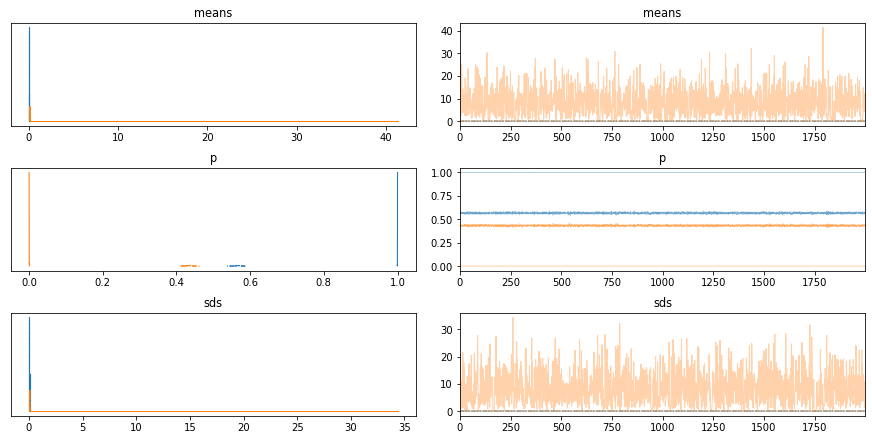

In [101]:
clusters = 2
with pm.Model() as model_mgp:
    p = pm.Dirichlet('p', a=np.ones(clusters))
    means = pm.Normal('means', mu=[0.05, 0.2], sd=10,
                      shape=clusters, transform=pm.distributions.transforms.ordered)
    sds = pm.HalfNormal('sds', sd=10, shape=clusters)
    y = pm.NormalMixture('y', w=p, mu=means, sd=sds, observed=data)
    trace_mgp = pm.sample(2000)
    
varnames = ['means', 'p', 'sds']
az.plot_trace(trace_mgp, varnames);

In [102]:
summary_df = az.summary(trace_mgp, varnames)
summary_df

/home/arsde/.local/lib/python3.8/site-packages/arviz/data/io_pymc3.py:96: FutureWarning:

Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.



,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
means[0],0.040,0.017,0.030,0.070,0.008,0.006,7.0,30.0,1.53
means[1],2.135,4.629,0.086,12.039,1.760,1.301,7.0,29.0,1.53
p[0],0.675,0.188,0.558,1.000,0.094,0.072,7.0,31.0,1.53
p[1],0.325,0.188,0.000,0.442,0.094,0.072,7.0,31.0,1.53
sds[0],0.025,0.022,0.012,0.063,0.011,0.008,7.0,30.0,1.53
sds[1],2.059,4.572,0.036,11.671,1.745,1.291,7.0,28.0,1.53


In [105]:
from scipy import stats
x = np.linspace(data.min(), data.max(), 100)
p1 = stats.norm.pdf(x, summary_df.loc['means[0]']['mean'], summary_df.loc['sds[0]']['mean'])
p2 = stats.norm.pdf(x, summary_df.loc['means[1]']['mean'], summary_df.loc['sds[1]']['mean'])

fig = go.Figure()

fig.add_trace(
    go.Histogram(
        x=data,
        histnorm='probability density',
        name='data'
    )
)

fig.add_trace(
    go.Scattergl(
        x=x,
        y=p1,
        mode='lines',
        name='gaussian 1'
    )
)

fig.add_trace(
    go.Scattergl(
        x=x,
        y=p2,
        name='gaussian 2'
    )
)

fig.add_trace(
    go.Scattergl(
        x=x,
        y=p1+p2,
        mode='lines',
        name='gaussians sum'
    )
)

fig.update_layout(
    xaxis_title=r"$$E_{rec} - E_{true}$$",
    title=options[1]
)

fig.show()